In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
import seaborn as sns

# Constants

In [2]:
r=0.9
D1=4
D2=4.8
q1=0.8
mu=0.05
q2=0.9
c=0.05
B=5
phi1=0.1
phi2=0.15
p=0.05

# Variables

In [3]:
K=5
A=0.9
tau=0.45
lam=0.02

In [4]:
def ODEs(t,u,K,A,tau,lam):
    return [r*u[0]*(1-(u[0]+u[1])/K)-lam*u[0]*u[1]-((q1*u[0]*u[2])/(u[0]+D1)),
            lam*u[0]*u[1]-mu*u[1]-(q2*u[1]*u[2])/(u[1]+D2),
           phi1*u[2]*((q1*(u[3]-tau)*u[0])/(u[0]+D1)+(q2*(p-tau)*u[1])/(u[1]+D2)-c),
           phi2*u[3]*(A/(1+B*u[3])-(q1*u[0]*u[2])/(u[0]+D1))]

# Initial Conditions

In [5]:
con1=np.array([2,1.5,0.8,0.5])
con2=np.array([3,2.5,1.8,1.5])
con3=np.array([5,3.5,2.8,2.5])
con4=np.array([4,2.7,1.2,1.8])
con5=np.array([4,2.7,0,0])
allcon=np.array([con1,con2,con3,con4])

# Animations for $\lambda$

In [6]:
linestyle=np.array(['solid','dotted','dashed','dashdot'])
K=5
A=0.9
tau=0.45
lam=0.04
t_span=np.array([0,1000])
times=np.linspace(t_span[0],t_span[1],1001)
def plotgraphs(initcon,K,A,tau,lam,index):
    soln=solve_ivp(ODEs,t_span,initcon,args=(K,A,tau,lam),t_eval=times)
    t=soln.t
    X=soln.y[0]
    Y=soln.y[1]
    H=soln.y[2]
    P=soln.y[3]
    if (index==0):
        return t
    elif (index==1):
        return X
    elif (index==2):
        return Y
    elif (index==3):
        return H
    elif (index==4):
        return P 

In [7]:
import random
import numpy as np
import operator
import math
import matplotlib.pyplot as plt
import pandas as pd
from IPython import display 

import matplotlib.animation as anim
from IPython.display import HTML
plt.rcParams["animation.html"] = "jshtml"
linestyle2=np.array(['solid','dotted','dashed','dashdot'])
def change(lamdas):

    fig, ax = plt.subplots(figsize = (15,10))

    #ax.set_aspect('equal')

    def animate(n): #Animation function
        while(n<len(lamdas)):
            ax.cla() 
            i=0
            p=ax.plot(plotgraphs(allcon[i],K,A,tau,lamdas[n],0),plotgraphs(allcon[i],K,A,tau,lamdas[n],1),linestyle=linestyle2[i],color='black',label='Healthy Fish')
            p1=ax.plot(plotgraphs(allcon[i],K,A,tau,lamdas[n],0),plotgraphs(allcon[i],K,A,tau,lamdas[n],2),linestyle=linestyle2[i],color='red',label='Infected Fish')
            p2=ax.plot(plotgraphs(allcon[i],K,A,tau,lamdas[n],0),plotgraphs(allcon[i],K,A,tau,lamdas[n],3),linestyle=linestyle2[i],color='blue',label='Harvesting Effort')
            p3=ax.plot(plotgraphs(allcon[i],K,A,tau,lamdas[n],0),plotgraphs(allcon[i],K,A,tau,lamdas[n],4),linestyle=linestyle2[i],color='green',label='Price')
            ax.set_ylim((0,5))
            fig.legend(prop = { "size": 20 })
            plt.title('$\lambda$=%.4f'%lamdas[n],size=25)
            plt.xlabel('Time (days)',size=20)
            plt.ylabel('State Variables',size=20)
            return ax
    return anim.FuncAnimation(fig, animate,frames=len(lamdas)-1, interval=300)

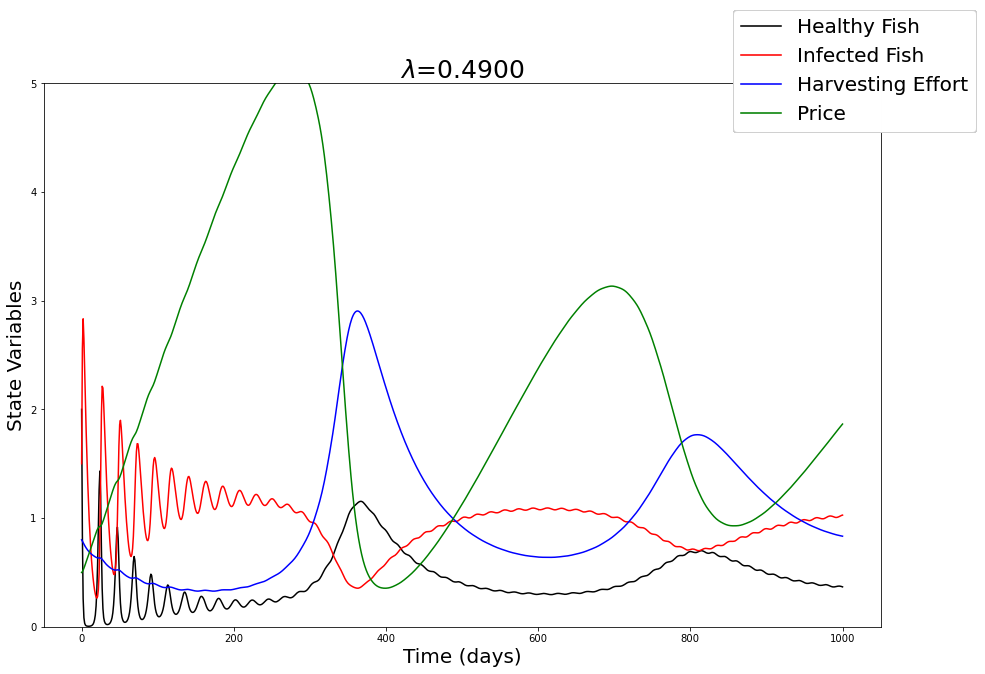

In [8]:
lamdas=np.linspace(0.01,0.5,50)
change(lamdas)
#anim.save('animation for lambda t=1000.gif')

Text(0, 0.5, 'State Variables')

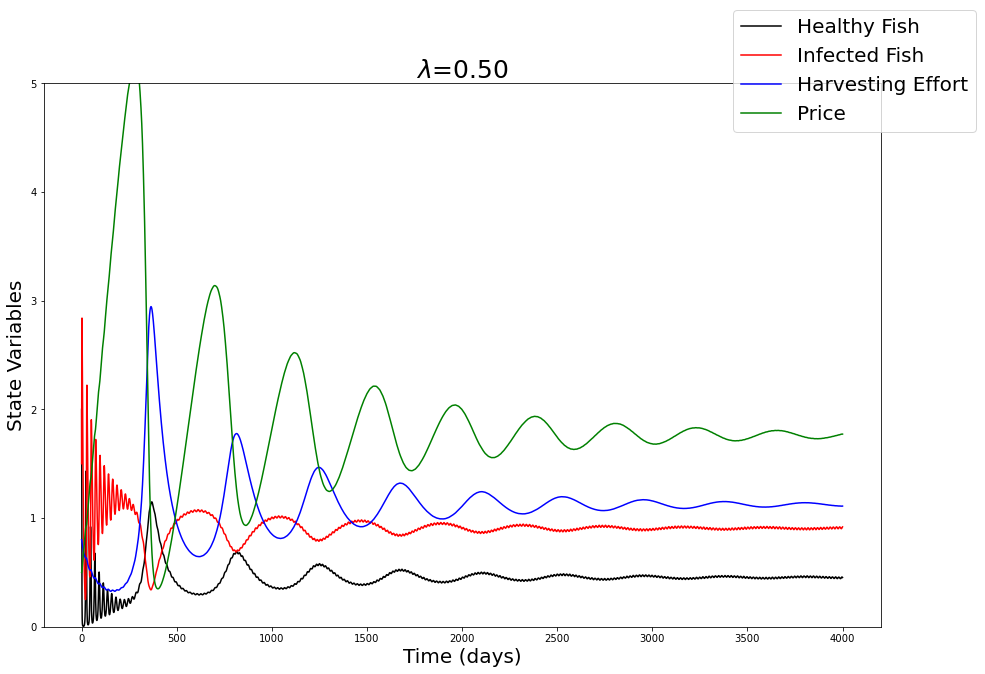

In [9]:
linestyle=np.array(['solid','dotted','dashed','dashdot'])
K=5
A=0.9
tau=0.45
lam=0.04
t_span=np.array([0,4000])
times=np.linspace(t_span[0],t_span[1],4001)
def plotgraphs(initcon,K,A,tau,lam,index):
    soln=solve_ivp(ODEs,t_span,initcon,args=(K,A,tau,lam),t_eval=times)
    t=soln.t
    X=soln.y[0]
    Y=soln.y[1]
    H=soln.y[2]
    P=soln.y[3]
    if (index==0):
        return t
    elif (index==1):
        return X
    elif (index==2):
        return Y
    elif (index==3):
        return H
    elif (index==4):
        return P 
fig=plt.figure(figsize=(15,10))
i=0
plt.plot(plotgraphs(allcon[i],K,A,tau,0.5,0),plotgraphs(allcon[i],K,A,tau,0.5,1),linestyle=linestyle2[i],color='black',label='Healthy Fish')
plt.plot(plotgraphs(allcon[i],K,A,tau,0.5,0),plotgraphs(allcon[i],K,A,tau,0.5,2),linestyle=linestyle2[i],color='red',label='Infected Fish')
plt.plot(plotgraphs(allcon[i],K,A,tau,0.5,0),plotgraphs(allcon[i],K,A,tau,0.5,3),linestyle=linestyle2[i],color='blue',label='Harvesting Effort')
plt.plot(plotgraphs(allcon[i],K,A,tau,0.5,0),plotgraphs(allcon[i],K,A,tau,0.5,4),linestyle=linestyle2[i],color='green',label='Price')
plt.ylim((0,5))
fig.legend(prop = { "size": 20 })
plt.title('$\lambda$=%.2f'%0.5,size=25)
plt.xlabel('Time (days)',size=20)
plt.ylabel('State Variables',size=20)
#plt.savefig('large lambda goes to endemic state')

In [10]:
linestyle=np.array(['solid','dotted','dashed','dashdot'])
K=5
A=0.9
tau=0.45
lam=0.04
t_span=np.array([0,1000])
times=np.linspace(t_span[0],t_span[1],1001)
Krange=np.linspace(0.1,10,100)
def plotgraphs(initcon,K,A,tau,lam,index):
    soln=solve_ivp(ODEs,t_span,initcon,args=(K,A,tau,lam),t_eval=times)
    t=soln.t
    X=soln.y[0]
    Y=soln.y[1]
    H=soln.y[2]
    P=soln.y[3]
    if (index==0):
        return t
    elif (index==1):
        return X
    elif (index==2):
        return Y
    elif (index==3):
        return H
    elif (index==4):
        return P 

In [11]:
import random
import numpy as np
import operator
import math
import matplotlib.pyplot as plt
import pandas as pd
from IPython import display 

import matplotlib.animation as anim
from IPython.display import HTML
plt.rcParams["animation.html"] = "jshtml"
linestyle2=np.array(['solid','dotted','dashed','dashdot'])
def change(Krange):

    fig, ax = plt.subplots(figsize = (15,10))

    #ax.set_aspect('equal')

    def animate(n): #Animation function
        while(n<len(Krange)):
            ax.cla() 
            i=0
            p=ax.plot(plotgraphs(allcon[i],Krange[n],A,tau,lam,0),plotgraphs(allcon[i],Krange[n],A,tau,lam,1),linestyle=linestyle2[i],color='black',label='Healthy Fish')
            p1=ax.plot(plotgraphs(allcon[i],Krange[n],A,tau,lam,0),plotgraphs(allcon[i],Krange[n],A,tau,lam,2),linestyle=linestyle2[i],color='red',label='Infected Fish')
            p2=ax.plot(plotgraphs(allcon[i],Krange[n],A,tau,lam,0),plotgraphs(allcon[i],Krange[n],A,tau,lam,3),linestyle=linestyle2[i],color='blue',label='Harvesting Effort')
            p3=ax.plot(plotgraphs(allcon[i],Krange[n],A,tau,lam,0),plotgraphs(allcon[i],Krange[n],A,tau,lam,4),linestyle=linestyle2[i],color='green',label='Price')
            ax.set_ylim((0,8))
            fig.legend(prop = { "size": 20 })
            plt.title('$K$=%.2f'%Krange[n],size=25)
            plt.xlabel('Time (days)',size=20)
            plt.ylabel('State Variables',size=20)
            return ax
    return anim.FuncAnimation(fig, animate,frames=len(Krange)-1, interval=300)

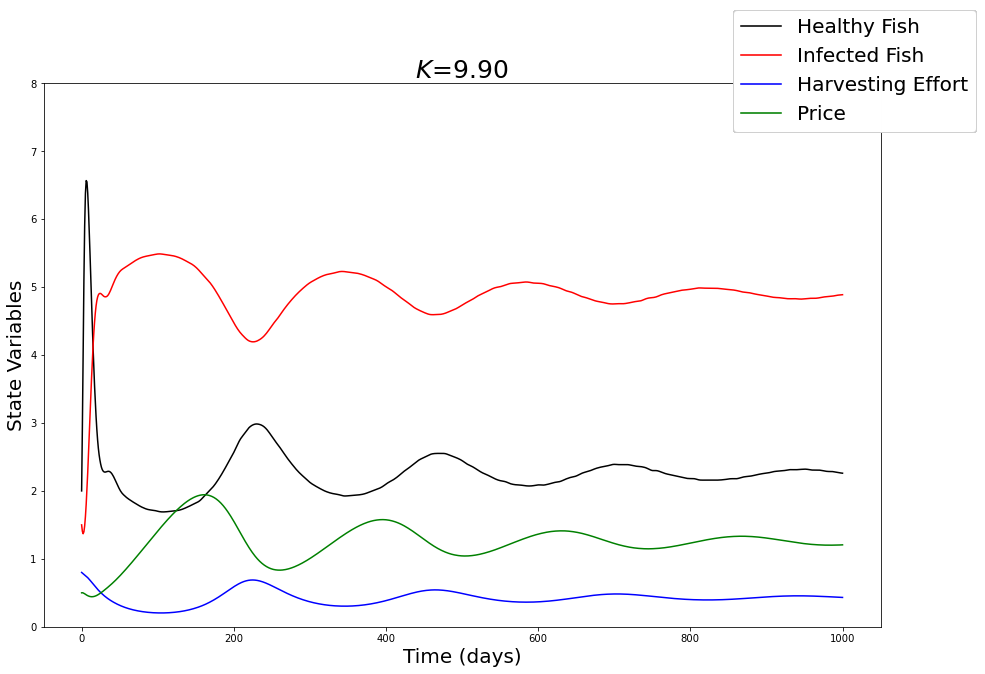

In [12]:
Krange=np.linspace(0.1,10,100)
change(Krange)
#anim.save('animation for K t=1000.gif')

Text(0, 0.5, 'State Variables')

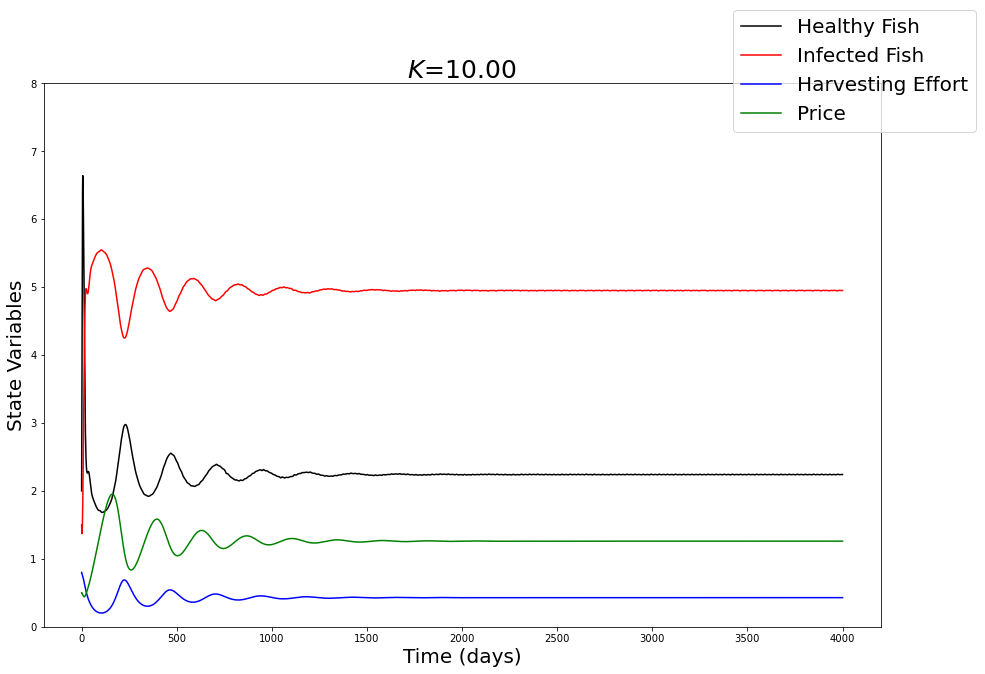

In [13]:
linestyle=np.array(['solid','dotted','dashed','dashdot'])
K=5
A=0.9
tau=0.45
lam=0.04
t_span=np.array([0,4000])
times=np.linspace(t_span[0],t_span[1],4001)
def plotgraphs(initcon,K,A,tau,lam,index):
    soln=solve_ivp(ODEs,t_span,initcon,args=(K,A,tau,lam),t_eval=times)
    t=soln.t
    X=soln.y[0]
    Y=soln.y[1]
    H=soln.y[2]
    P=soln.y[3]
    if (index==0):
        return t
    elif (index==1):
        return X
    elif (index==2):
        return Y
    elif (index==3):
        return H
    elif (index==4):
        return P 
fig=plt.figure(figsize=(15,10))
i=0
plt.plot(plotgraphs(allcon[i],10,A,tau,lam,0),plotgraphs(allcon[i],10,A,tau,lam,1),linestyle=linestyle2[i],color='black',label='Healthy Fish')
plt.plot(plotgraphs(allcon[i],10,A,tau,lam,0),plotgraphs(allcon[i],10,A,tau,lam,2),linestyle=linestyle2[i],color='red',label='Infected Fish')
plt.plot(plotgraphs(allcon[i],10,A,tau,lam,0),plotgraphs(allcon[i],10,A,tau,lam,3),linestyle=linestyle2[i],color='blue',label='Harvesting Effort')
plt.plot(plotgraphs(allcon[i],10,A,tau,lam,0),plotgraphs(allcon[i],10,A,tau,lam,4),linestyle=linestyle2[i],color='green',label='Price')
plt.ylim((0,8))
fig.legend(prop = { "size": 20 })
plt.title('$K$=%.2f'%10,size=25)
plt.xlabel('Time (days)',size=20)
plt.ylabel('State Variables',size=20)
#plt.savefig('large K goes to endemic state')

In [14]:
linestyle=np.array(['solid','dotted','dashed','dashdot'])
K=5
A=0.9
tau=0.45
lam=0.04
t_span=np.array([0,1000])
times=np.linspace(t_span[0],t_span[1],1001)
Arange=np.linspace(0.1,5,10)

def plotgraphs(initcon,K,A,tau,lam,index):
    soln=solve_ivp(ODEs,t_span,initcon,args=(K,A,tau,lam),t_eval=times)
    t=soln.t
    X=soln.y[0]
    Y=soln.y[1]
    H=soln.y[2]
    P=soln.y[3]
    if (index==0):
        return t
    elif (index==1):
        return X
    elif (index==2):
        return Y
    elif (index==3):
        return H
    elif (index==4):
        return P 

In [15]:
import random
import numpy as np
import operator
import math
import matplotlib.pyplot as plt
import pandas as pd
from IPython import display 

import matplotlib.animation as anim
from IPython.display import HTML
plt.rcParams["animation.html"] = "jshtml"
linestyle2=np.array(['solid','dotted','dashed','dashdot'])
def change(Arange):

    fig, ax = plt.subplots(figsize = (15,10))

    #ax.set_aspect('equal')

    def animate(n): #Animation function
        while(n<len(Arange)):
            ax.cla() 
            i=0
            p=ax.plot(plotgraphs(allcon[i],K,Arange[n],tau,lam,0),plotgraphs(allcon[i],K,Arange[n],tau,lam,1),linestyle=linestyle2[i],color='black',label='Healthy Fish')
            p1=ax.plot(plotgraphs(allcon[i],K,Arange[n],tau,lam,0),plotgraphs(allcon[i],K,Arange[n],tau,lam,2),linestyle=linestyle2[i],color='red',label='Infected Fish')
            p2=ax.plot(plotgraphs(allcon[i],K,Arange[n],tau,lam,0),plotgraphs(allcon[i],K,Arange[n],tau,lam,3),linestyle=linestyle2[i],color='blue',label='Harvesting Effort')
            p3=ax.plot(plotgraphs(allcon[i],K,Arange[n],tau,lam,0),plotgraphs(allcon[i],K,Arange[n],tau,lam,4),linestyle=linestyle2[i],color='green',label='Price')
            ax.set_ylim((0,5))
            fig.legend(prop = { "size": 20 })
            plt.title('$A$=%.2f'%Arange[n],size=25)
            plt.xlabel('Time (days)',size=20)
            plt.ylabel('State Variables',size=20)
            return ax
    return anim.FuncAnimation(fig, animate,frames=len(Arange)-1, interval=300)

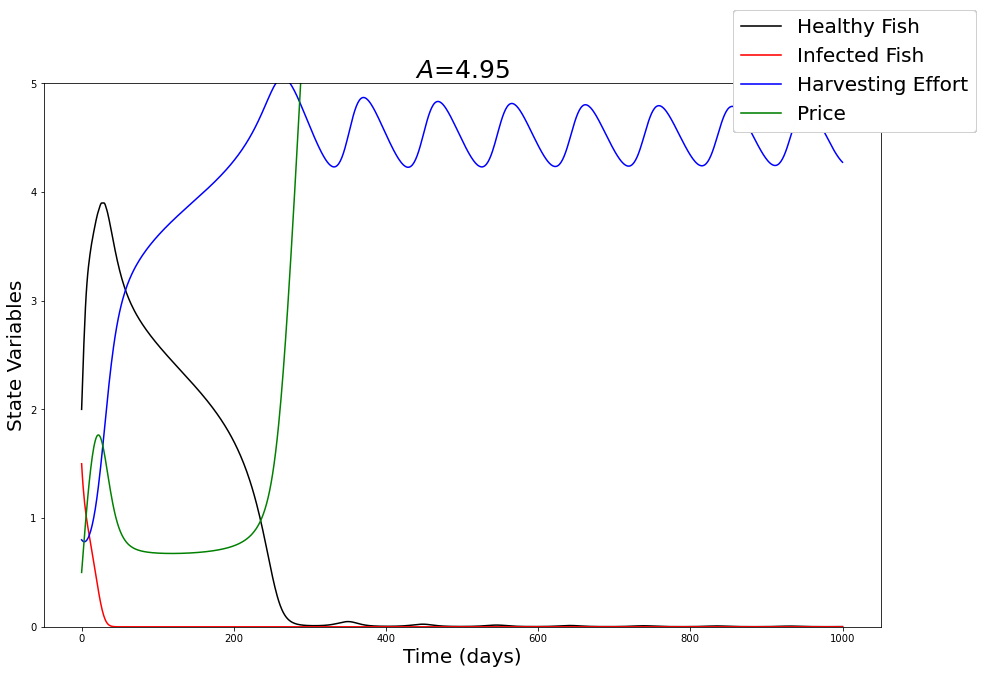

In [16]:
Arange=np.linspace(0.1,5,100)
change(Arange)
#anim.save('animation for A t=1000.gif')

In [17]:
linestyle=np.array(['solid','dotted','dashed','dashdot'])
K=5
A=0.9
tau=0.45
lam=0.04
t_span=np.array([0,1000])
times=np.linspace(t_span[0],t_span[1],1001)
taurange=np.linspace(0.01,0.6,100)

def plotgraphs(initcon,K,A,tau,lam,index):
    soln=solve_ivp(ODEs,t_span,initcon,args=(K,A,tau,lam),t_eval=times)
    t=soln.t
    X=soln.y[0]
    Y=soln.y[1]
    H=soln.y[2]
    P=soln.y[3]
    if (index==0):
        return t
    elif (index==1):
        return X
    elif (index==2):
        return Y
    elif (index==3):
        return H
    elif (index==4):
        return P 

In [18]:
import random
import numpy as np
import operator
import math
import matplotlib.pyplot as plt
import pandas as pd
from IPython import display 

import matplotlib.animation as anim
from IPython.display import HTML
plt.rcParams["animation.html"] = "jshtml"
linestyle2=np.array(['solid','dotted','dashed','dashdot'])
def change(taurange):

    fig, ax = plt.subplots(figsize = (15,10))

    #ax.set_aspect('equal')

    def animate(n): #Animation function
        while(n<len(taurange)):
            ax.cla() 
            i=0
            p=ax.plot(plotgraphs(allcon[i],K,A,taurange[n],lam,0),plotgraphs(allcon[i],K,A,taurange[n],lam,1),linestyle=linestyle2[i],color='black',label='Healthy Fish')
            p1=ax.plot(plotgraphs(allcon[i],K,A,taurange[n],lam,0),plotgraphs(allcon[i],K,A,taurange[n],lam,2),linestyle=linestyle2[i],color='red',label='Infected Fish')
            p2=ax.plot(plotgraphs(allcon[i],K,A,taurange[n],lam,0),plotgraphs(allcon[i],K,A,taurange[n],lam,3),linestyle=linestyle2[i],color='blue',label='Harvesting Effort')
            p3=ax.plot(plotgraphs(allcon[i],K,A,taurange[n],lam,0),plotgraphs(allcon[i],K,A,taurange[n],lam,4),linestyle=linestyle2[i],color='green',label='Price')
            ax.set_ylim((0,5))
            fig.legend(prop = { "size": 20 })
            plt.title('$\\tau$=%.4f'%taurange[n],size=25)
            plt.xlabel('Time (days)',size=20)
            plt.ylabel('State Variables',size=20)
            return ax
    return anim.FuncAnimation(fig, animate,frames=len(taurange)-1, interval=300)

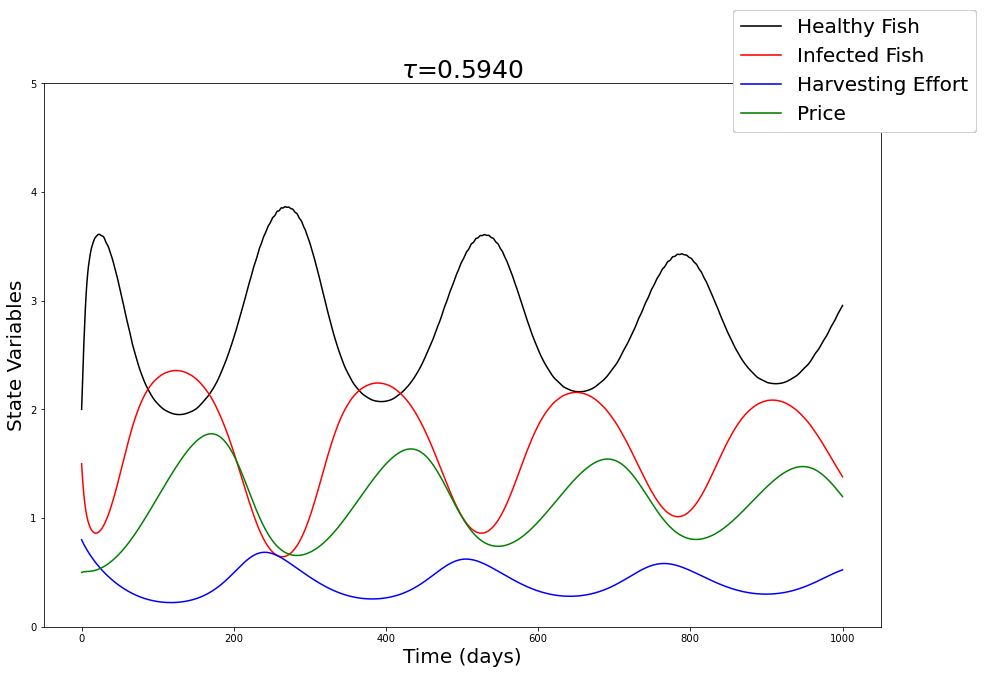

In [19]:
taurange=np.linspace(0.01,0.6,100)
change(taurange)
#anim.save('animation for tau t=1000.gif')

Text(0, 0.5, 'State Variables')

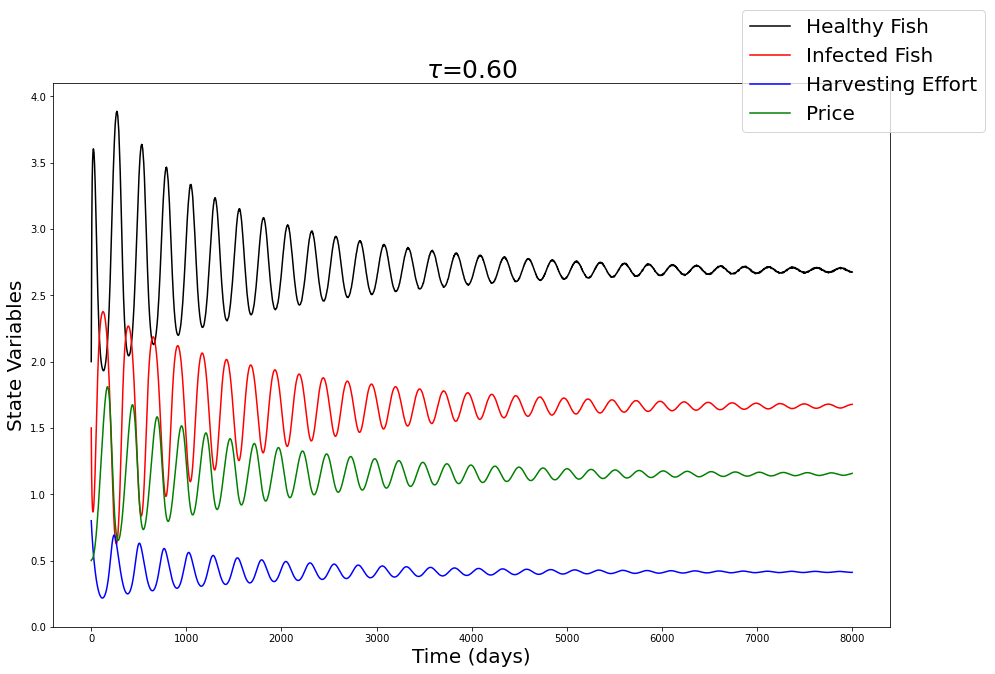

In [20]:
linestyle=np.array(['solid','dotted','dashed','dashdot'])
K=5
A=0.9
tau=0.45
lam=0.04
t_span=np.array([0,8000])
times=np.linspace(t_span[0],t_span[1],8001)
Arange=np.linspace(0.1,5,100)

def plotgraphs(initcon,K,A,tau,lam,index):
    soln=solve_ivp(ODEs,t_span,initcon,args=(K,A,tau,lam),t_eval=times)
    t=soln.t
    X=soln.y[0]
    Y=soln.y[1]
    H=soln.y[2]
    P=soln.y[3]
    if (index==0):
        return t
    elif (index==1):
        return X
    elif (index==2):
        return Y
    elif (index==3):
        return H
    elif (index==4):
        return P 
fig=plt.figure(figsize=(15,10))
i=0
plt.plot(plotgraphs(allcon[i],K,A,0.6,lam,0),plotgraphs(allcon[i],K,A,0.6,lam,1),linestyle=linestyle2[i],color='black',label='Healthy Fish')
plt.plot(plotgraphs(allcon[i],K,A,0.6,lam,0),plotgraphs(allcon[i],K,A,0.6,lam,2),linestyle=linestyle2[i],color='red',label='Infected Fish')
plt.plot(plotgraphs(allcon[i],K,A,0.6,lam,0),plotgraphs(allcon[i],K,A,0.6,lam,3),linestyle=linestyle2[i],color='blue',label='Harvesting Effort')
plt.plot(plotgraphs(allcon[i],K,A,0.6,lam,0),plotgraphs(allcon[i],K,A,0.6,lam,4),linestyle=linestyle2[i],color='green',label='Price')
plt.ylim((0,4.1))
fig.legend(prop = { "size": 20 })
plt.title('$\\tau$=%.2f'%0.6,size=25)
plt.xlabel('Time (days)',size=20)
plt.ylabel('State Variables',size=20)
#plt.savefig('large tau goes to endemic state')